# Detección y Seguimiento de Objetos con YOLO
* Ricardo Juan Cárdenes Pérez
* Laura Lasso García

In [1]:
import torch

device = (
    "cuda"
    if torch.cuda.is_available()
    else "mps"
    if torch.backends.mps.is_available()
    else "cpu"
)
print(f"Using {device} device")

Using cuda device


## Detección de manos con YOLO

In [2]:
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 896.9/896.9 kB 18.5 MB/s eta 0:00:00


In [3]:
from ultralytics import YOLO

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [4]:
model = YOLO('yolov8x-pose-p6.pt')

100%|██████████| 190M/190M [00:01<00:00, 105MB/s]


In [5]:
id = 0

In [6]:
class Person:
  def __init__(self, hand_left, hand_right):
    self.id = None
    self.hand_left = hand_left
    self.hand_right = hand_right
    self.tracking = []
    self.last_appear = 1
    self.activated = True

In [7]:
def draw_trace(image, person):
  for point in person.tracking:
    left_hand, right_hand, _ = point
    cv.circle(image, (int(left_hand[0]), int(left_hand[1])), 1, (0, 0, 255), -1)
    cv.circle(image, (int(right_hand[0]), int(right_hand[1])), 1, (0, 0, 255), -1)

  return image

In [8]:
def obtain_people(results):
  people = []
  for result in results:
    keypoints = result.keypoints.cpu().numpy()

    for person_keypoints in keypoints:
      left_hand = person_keypoints.xy[0, 9, :]
      right_hand = person_keypoints.xy[0, 10, :]

      person = Person(left_hand, right_hand)
      person.tracking.append((left_hand, right_hand, 0))
      people.append(person)

  return people

def match_people(people, results, frame):
  global id
  matched = {person: False for person in people}

  for result in results:
    exists = False
    keypoints = result.keypoints.cpu().numpy()
    for person_keypoints in keypoints:
      left_hand = person_keypoints.xy[0, 9, :]
      right_hand = person_keypoints.xy[0, 10, :]

      for person in people:
        if person.activated and not matched[person] and (np.linalg.norm(left_hand - person.hand_left) < 30 or np.linalg.norm(right_hand - person.hand_right) < 30):
          person.hand_left = left_hand
          person.hand_right = right_hand
          person.tracking.append((left_hand, right_hand, frame))
          person.last_appear = frame
          exists = True
          matched[person] = True

          if (len(person.tracking) > 15) and (person.id == None):
            person.id = id
            id += 1

          break

      if exists == False:
        person = Person(left_hand, right_hand)
        person.tracking.append((left_hand, right_hand, frame))
        person.last_appear = frame
        people.append(person)
        matched[person] = True

      for person in people:
        if person.last_appear < frame - 20:
          person.activated = False

  return people

def draw_people(people, image):
  for person in people:
    if person.id != None:
      left_hand = person.hand_left
      right_hand = person.hand_right

      cv.circle(image, (int(left_hand[0]), int(left_hand[1])), 10, (0, 255, 0), -1)
      cv.circle(image, (int(right_hand[0]), int(right_hand[1])), 10, (0, 255, 0), -1)

      cv.putText(image, f"Person: {person.id}", (int(left_hand[0]) + 10, int(left_hand[1]) + 10), cv.FONT_HERSHEY_SIMPLEX, 1.5, (0, 255, 0), 1)
      image = draw_trace(image, person)

  return image

In [9]:
import cv2 as cv
import torch
import numpy as np

video = cv.VideoCapture("data/people2.mp4")

status, img = video.read()
size=(1280, 1280)

fourcc = cv.VideoWriter_fourcc(*'DIVX')
video_out = cv.VideoWriter('outputs/video1.mp4', fourcc, 30.0, size)

frame = 0
people = []
id=0

blank_images = np.ones((1280,1280,3), dtype=np.uint8)

while status:
    orig = img.copy()
    orig = cv.resize(orig, (1280, 1280))

    detections = model(orig, imgsz=1280)

    if frame == 0:
        people = obtain_people(detections)

    else:
        people = match_people(people, detections, frame)

    output = draw_people(people, orig)

    cv.imwrite('output.jpg', output)
    video_out.write(output)

    status, img = video.read()

    frame += 1
    print(f"Frame: {frame}")
    if frame == 100:
        break

video.release()
video_out.release()



0: 1280x1280 21 persons, 197.5ms
Speed: 12.7ms preprocess, 197.5ms inference, 943.4ms postprocess per image at shape (1, 3, 1280, 1280)
Frame: 1

0: 1280x1280 20 persons, 205.0ms
Speed: 8.0ms preprocess, 205.0ms inference, 1.9ms postprocess per image at shape (1, 3, 1280, 1280)
Frame: 2

0: 1280x1280 20 persons, 207.0ms
Speed: 7.9ms preprocess, 207.0ms inference, 1.8ms postprocess per image at shape (1, 3, 1280, 1280)
Frame: 3

0: 1280x1280 23 persons, 209.8ms
Speed: 6.3ms preprocess, 209.8ms inference, 1.8ms postprocess per image at shape (1, 3, 1280, 1280)
Frame: 4

0: 1280x1280 21 persons, 207.2ms
Speed: 7.8ms preprocess, 207.2ms inference, 2.6ms postprocess per image at shape (1, 3, 1280, 1280)
Frame: 5

0: 1280x1280 19 persons, 206.9ms
Speed: 7.0ms preprocess, 206.9ms inference, 1.8ms postprocess per image at shape (1, 3, 1280, 1280)
Frame: 6

0: 1280x1280 18 persons, 205.6ms
Speed: 6.1ms preprocess, 205.6ms inference, 2.1ms postprocess per image at shape (1, 3, 1280, 1280)
Frame

#### Resultados

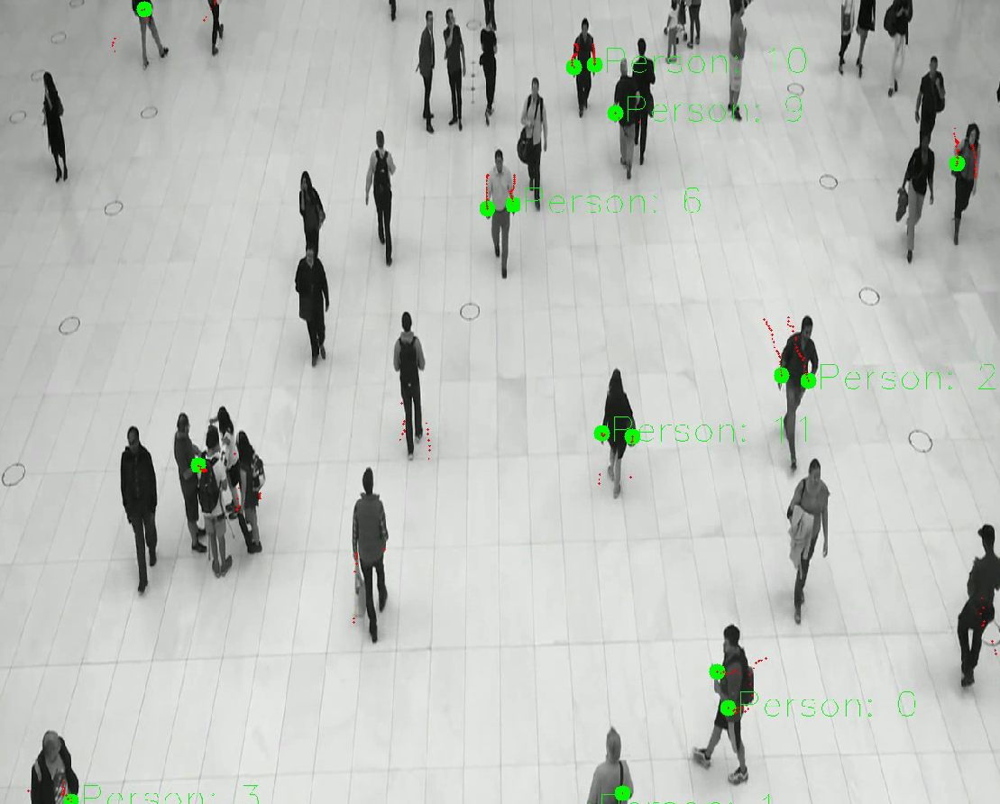

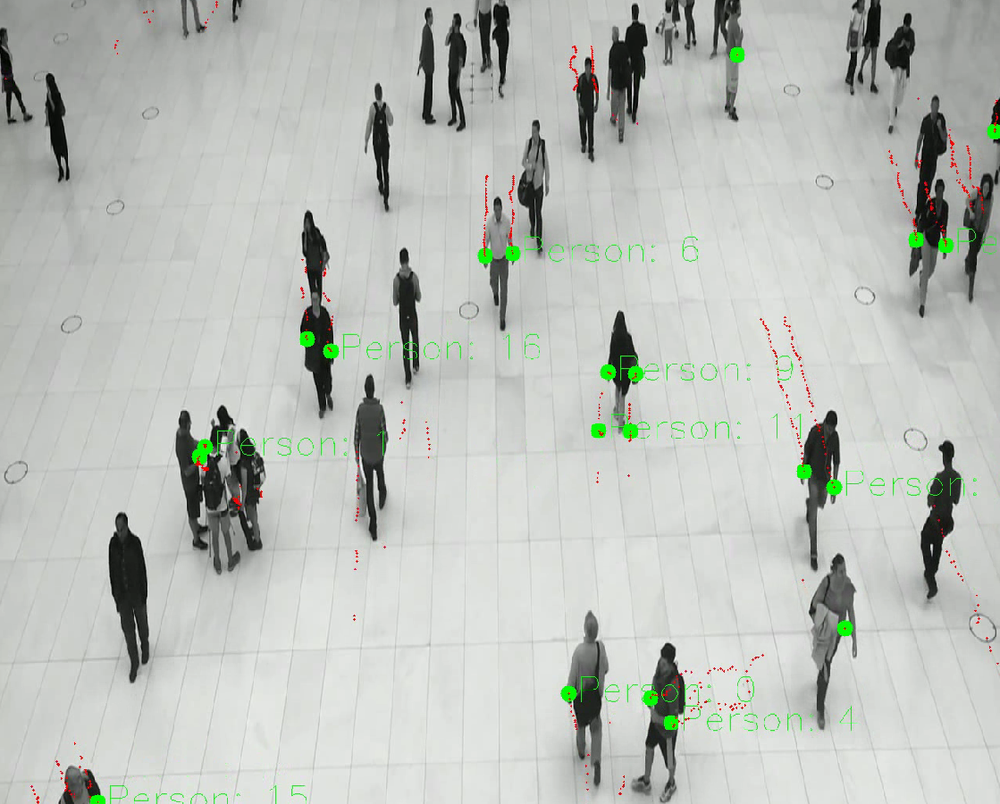

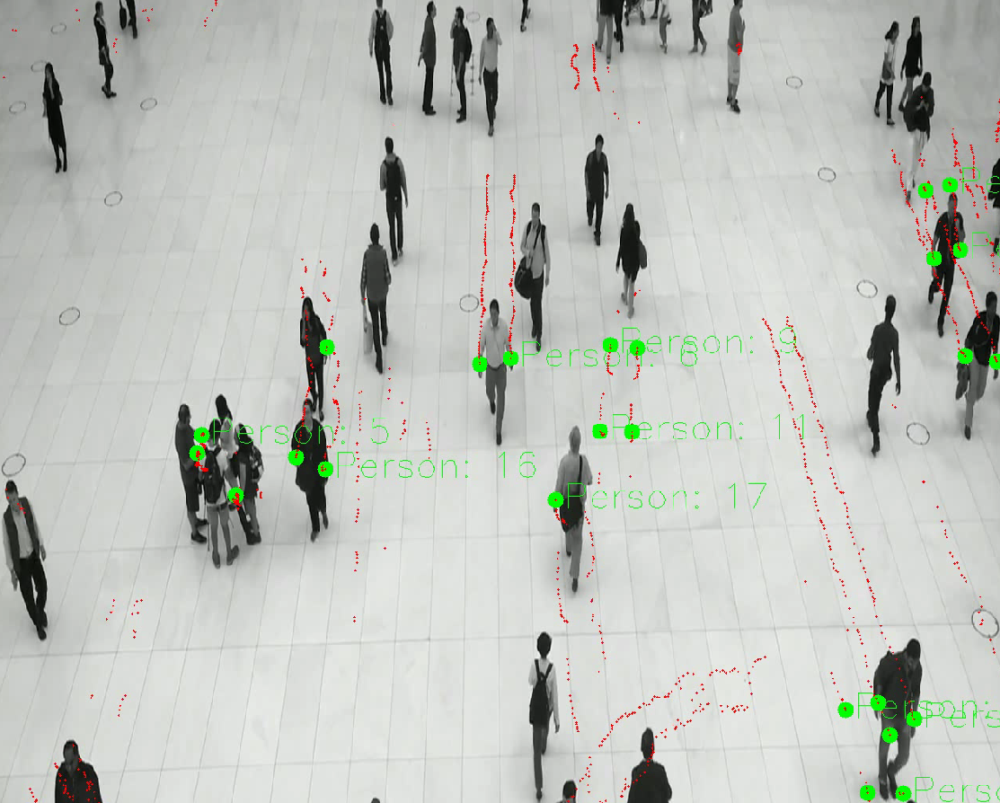

In [11]:
from google.colab.patches import cv2_imshow

img = cv.imread('Resultados_entrega/Resultados_YOLO/Resultado_YOLO_1.png')
img2 = cv.imread('Resultados_entrega/Resultados_YOLO/Resultado_YOLO_2.png')
img3 = cv.imread('Resultados_entrega/Resultados_YOLO/Resultado_YOLO_3.png')
cv2_imshow(img)
cv2_imshow(img2)
cv2_imshow(img3)

### Cálculo de movimiento

In [12]:
import matplotlib.pyplot as plt

In [13]:
velocities = {}

In [14]:
for person in people:
  if person.id != None:
    left_vel = []
    right_vel = []

    for i in range(len(person.tracking) - 1):
      left_hand_prev = person.tracking[i][0]
      right_hand_prev = person.tracking[i][1]
      frame_prev = person.tracking[i][2]

      left_hand = person.tracking[i + 1][0]
      right_hand = person.tracking[i + 1][1]
      frame = person.tracking[i + 1][2]

      left_hand_distance = np.linalg.norm(left_hand - left_hand_prev)
      right_hand_distance = np.linalg.norm(right_hand - right_hand_prev)
      time = frame - frame_prev

      left_vel.append(left_hand_distance/time)
      right_vel.append(right_hand_distance/time)

    velocities[person.id] = (left_vel, right_vel)

In [15]:
def show_velocity_plots(left, right, id):
  fig, ax = plt.subplots(1, 2, figsize=(10, 5))

  ax[0].plot(left)
  ax[1].plot(right)

  ax[0].set_title('Left Hand')
  ax[1].set_title('Right Hand')

  ax[0].set_xlabel('Frame')
  ax[1].set_xlabel('Frame')

  ax[0].set_ylabel('Velocity')
  ax[1].set_ylabel('Velocity')

  plt.suptitle('Hand Velocities (Person: ' + str(id) + ')')
  plt.show()

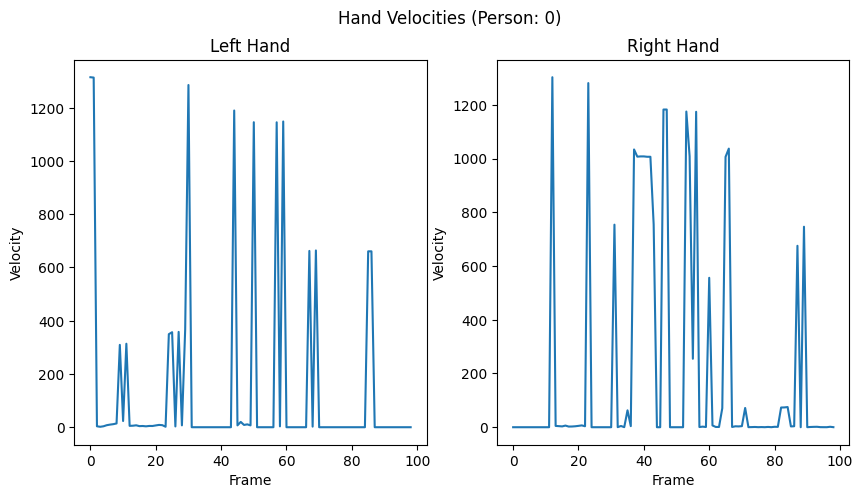

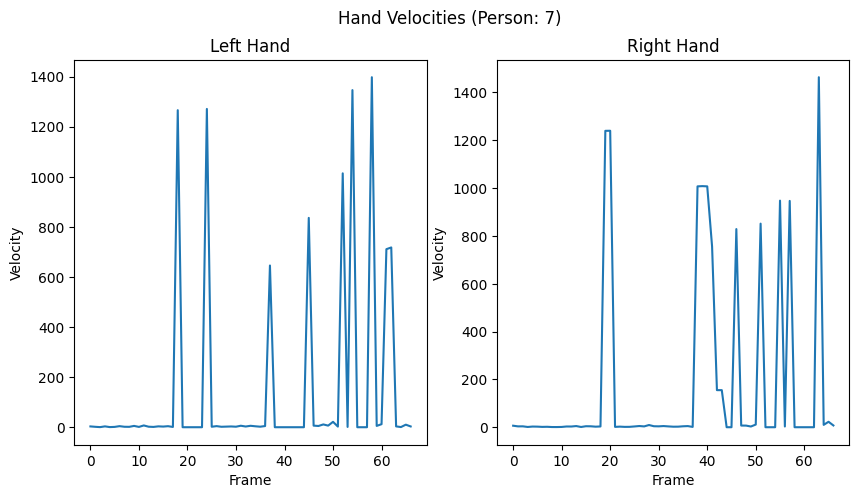

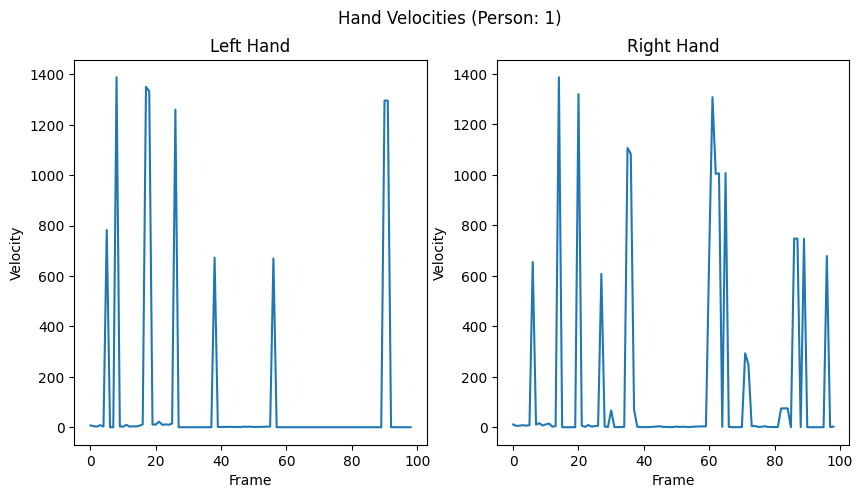

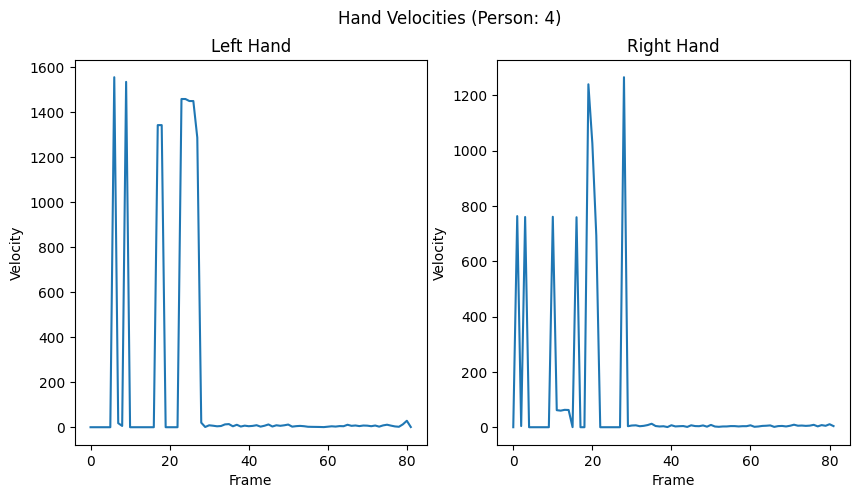

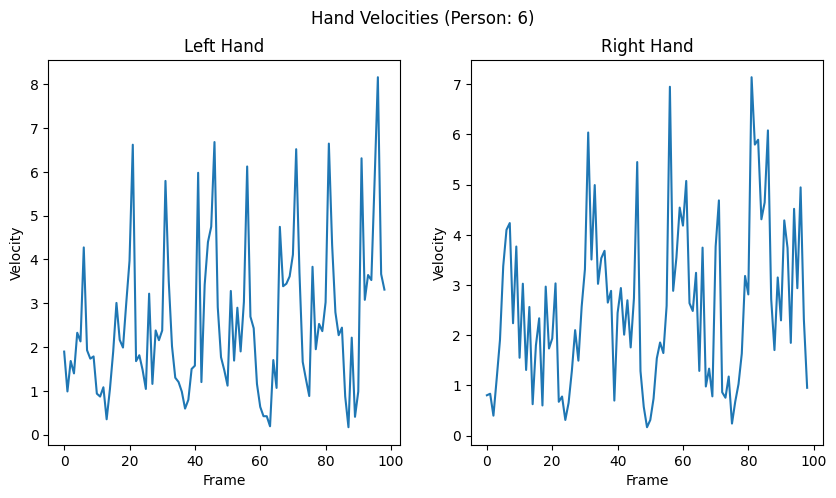

...

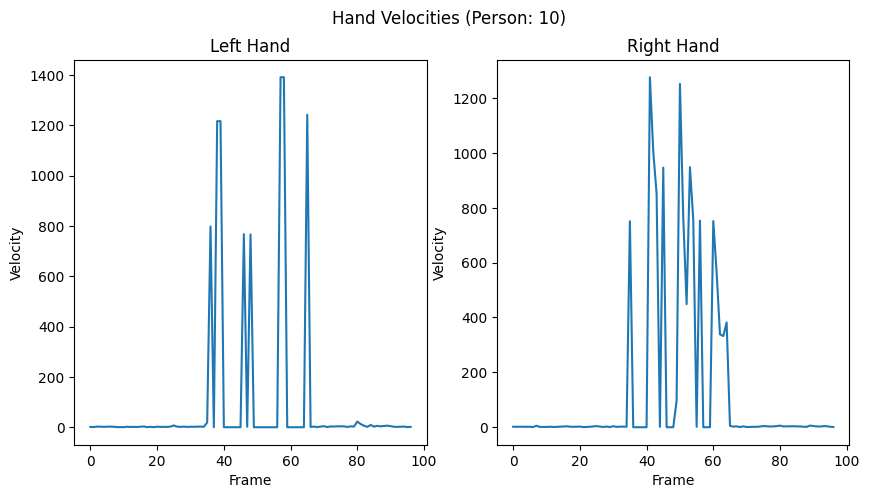

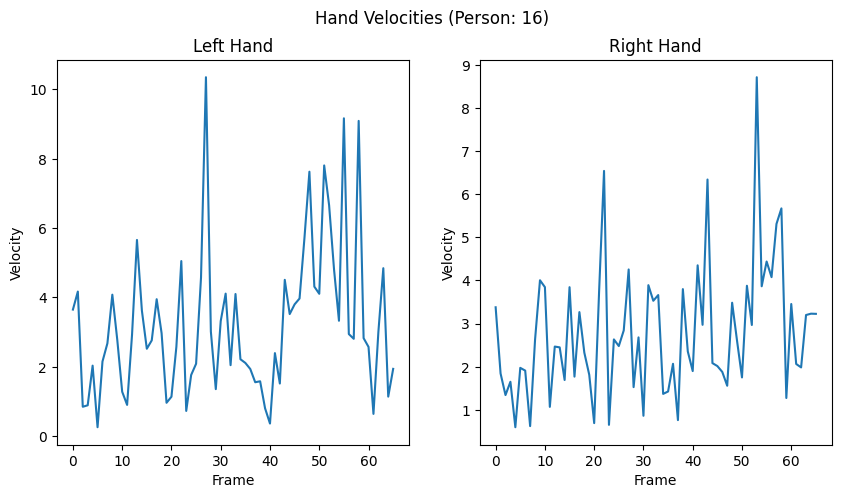

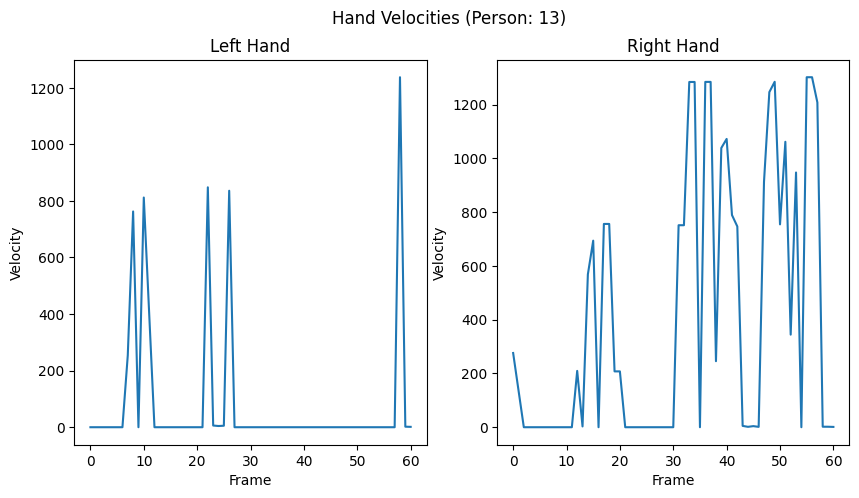

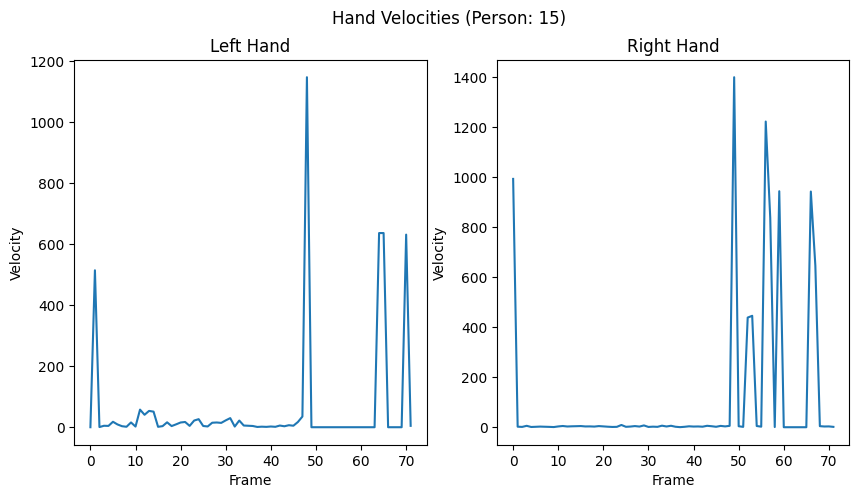

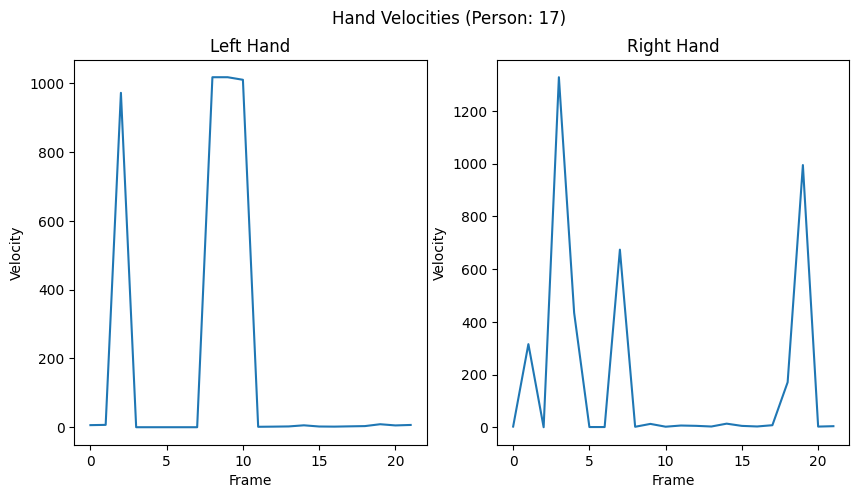

In [16]:
for identifier in velocities:
  left, right = velocities[identifier]
  show_velocity_plots(left, right, identifier)

Vemos como la persona con id 6 es aquella de las que tenemos una mayor trazibilidad. Así, si la graficamos en el vídeo, obtenemos lo siguiente:

### Detección de manos con YOLO (una sola persona)

In [18]:
import random

In [19]:
tracking_people = [person for person in people if person.id in [6]]

In [20]:
tracking_people.sort(key=lambda person: person.id)

In [21]:
tracking_people

In [22]:
colors = {person.id: (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255)) for person in people}
ids = {person: i for i, person in enumerate(tracking_people)}

def draw_until_current_frame(people, image, frame):
  global colors, ids
  for person in people:
    for i, point in enumerate(person.tracking):
      if point[2] <= frame:
        left_hand, right_hand, _ = point
        cv.circle(image, (int(right_hand[0]), int(right_hand[1])), 1, colors[person.id], -1)

        if point[2] == frame:
          cv.putText(image, f"Person: {ids[person]}", (int(left_hand[0]) + 10, int(left_hand[1]) + 10), cv.FONT_HERSHEY_SIMPLEX, 1.5, (0, 255, 0), 1)

  return image

In [24]:
video = cv.VideoCapture("data/people2.mp4")

status, img = video.read()
size=(1280, 1280)

fourcc = cv.VideoWriter_fourcc(*'DIVX')
video_out = cv.VideoWriter('outputs/video1.mp4', fourcc, 30.0, size)

frame = 0

while status:
    orig = img.copy()
    orig = cv.resize(orig, (1280, 1280))

    output = draw_until_current_frame(tracking_people, orig, frame)
    cv.imwrite('output.jpg', output)
    video_out.write(output)

    status, img = video.read()

    frame += 1
    if frame == 100:
        break

video.release()
video_out.release()

(array([      654.2,      278.17], dtype=float32), array([     621.49,      278.02], dtype=float32), 0)
(array([     654.51,      280.04], dtype=float32), array([     620.75,      278.32], dtype=float32), 1)
(array([     654.87,      280.96], dtype=float32), array([     620.53,      279.13], dtype=float32), 2)
(array([     654.78,      282.64], dtype=float32), array([     620.36,      279.49], dtype=float32), 3)
(array([     654.88,      284.03], dtype=float32), array([     619.94,      280.54], dtype=float32), 4)
(array([     654.85,      286.36], dtype=float32), array([        620,      282.44], dtype=float32), 5)
(array([     654.43,      288.44], dtype=float32), array([     619.87,      285.81], dtype=float32), 6)
(array([     653.59,      292.63], dtype=float32), array([     619.68,      289.91], dtype=float32), 7)
(array([     653.12,       294.5], dtype=float32), array([     619.09,       294.1], dtype=float32), 8)
(array([     652.49,      296.11], dtype=float32), array([     6

#### Resultados

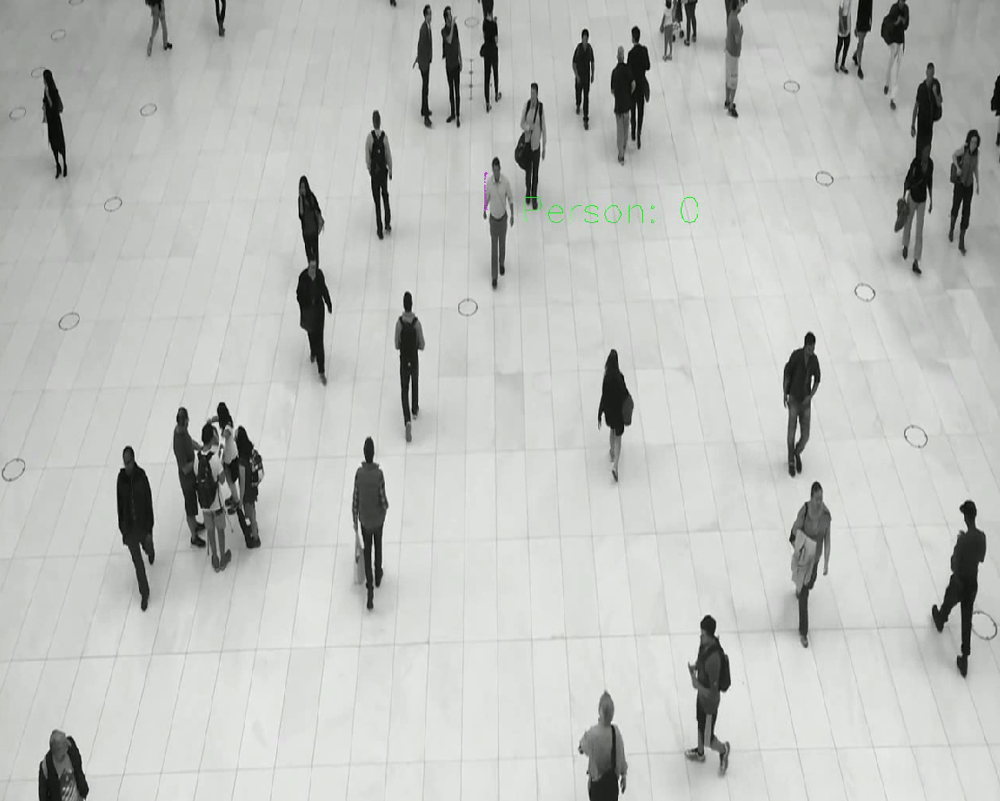

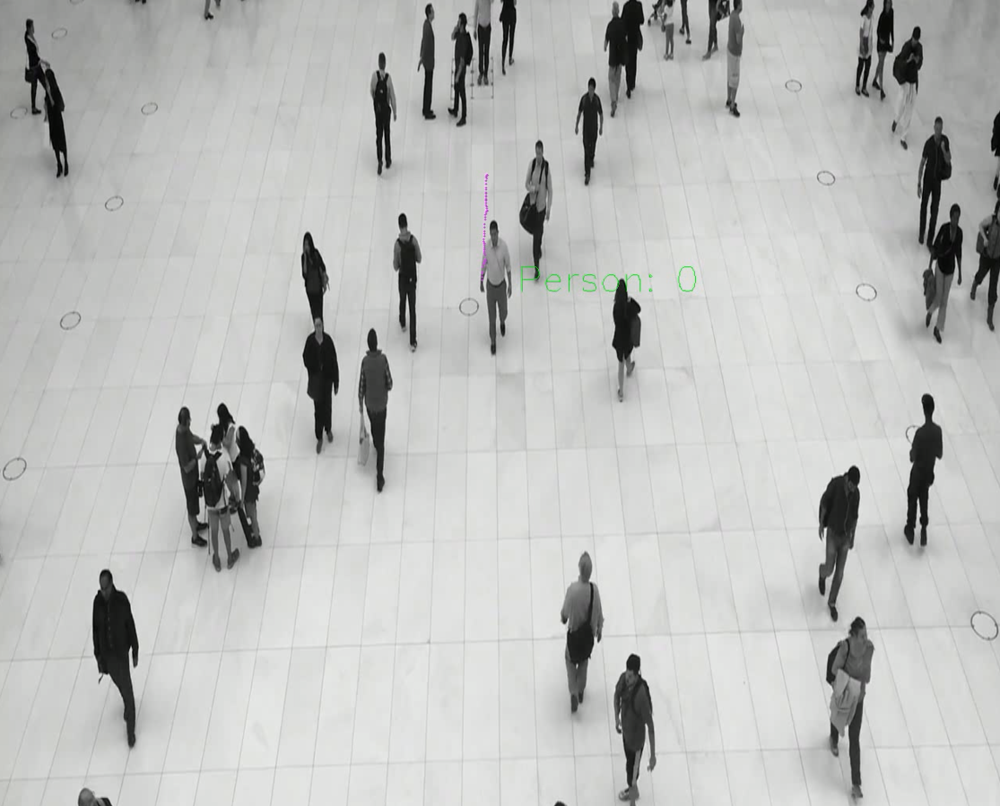

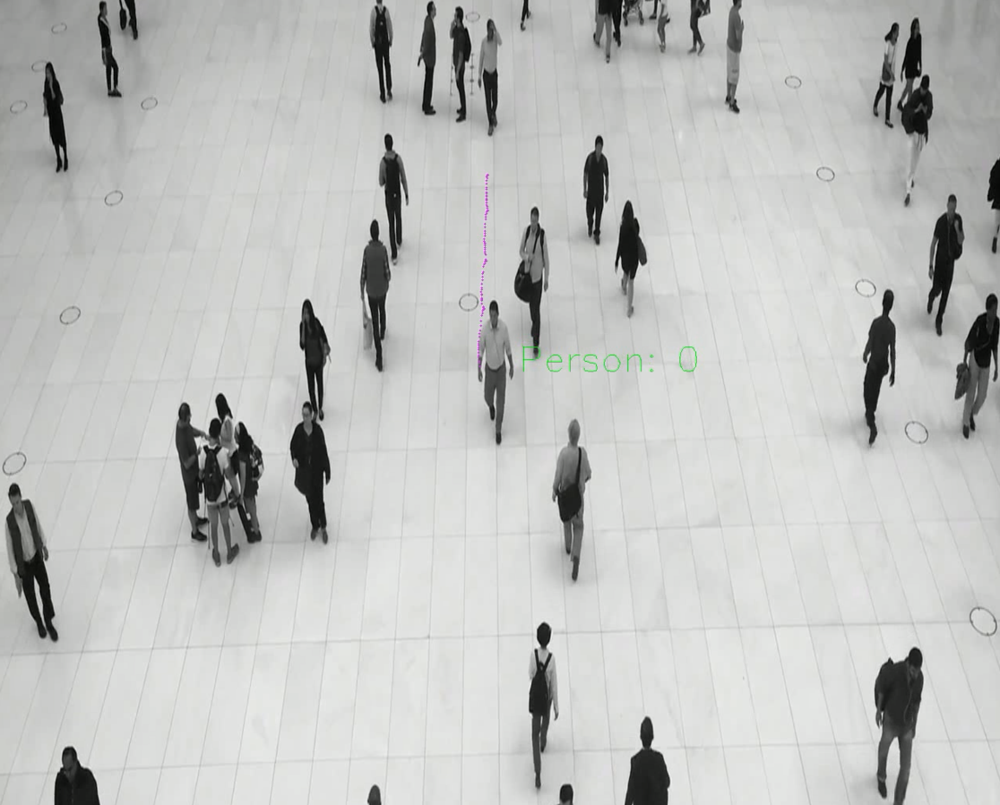

In [26]:
img = cv.imread('Resultados_entrega/Resultados_YOLO_una_persona/Resultado_YOLO_1.png')
img2 = cv.imread('Resultados_entrega/Resultados_YOLO_una_persona/Resultado_YOLO_2.png')
img3 = cv.imread('Resultados_entrega/Resultados_YOLO_una_persona/Resultado_YOLO_3.png')
cv2_imshow(img)
cv2_imshow(img2)
cv2_imshow(img3)

### Método Lucas-Kanade a mano

In [27]:
import copy
people = copy.deepcopy(tracking_people)

El método Lucas-Kanade estima el flujo óptico entre dos imágenes consecutivas al calcular el desplazamiento de pequeños bloques de píxeles (ventanas) bajo la suposición de que la intensidad de los píxeles no cambia con el movimiento. Usa una aproximación lineal basada en gradientes espaciales ($I_x, I_y$) y temporales ($I_t$) dentro de cada ventana para resolver un sistema de ecuaciones que determina el desplazamiento en los ejes $x$ e $y$. Es eficiente para rastrear movimientos pequeños y suaves, pero puede requerir refinamiento multiescala para manejar desplazamientos más grandes.

La siguiente función 'calculate_optical_flow' emplea gradientes espaciales ($I_x$ e $I_y$) calculados con el operador Sobel y el gradiente temporal ($I_t$) derivado de la diferencia entre imágenes suavizadas, siguiendo el uso del gradiente de intensidad espacial para estimar desplazamientos entre imágenes descrito.

El cálculo del flujo óptico mediante el sistema lineal $A^T A \cdot h = A^T b$ implementa el modelo iterativo de Newton-Raphson para minimizar diferencias cuadráticas y encontrar el vector de disparidad $h$.

Además, el suavizado Gaussiano aplicado a las imágenes concuerda con la recomendación de eliminar frecuencias altas para mejorar la convergencia, lo que es buena opción para movimientos pequeños, como lo sugiere la condición de convergencia en el caso de traslaciones simples descrita en el documento.

In [28]:
def calculate_optical_flow(prev_img, curr_img, points_prev):
    flow_vectors = []
    prev_img_blur = cv.GaussianBlur(prev_img, (5, 5), 1)
    curr_img_blur = cv.GaussianBlur(curr_img, (5, 5), 1)
    Ix = cv.Sobel(prev_img_blur, cv.CV_64F, 1, 0, ksize=5)
    Iy = cv.Sobel(prev_img_blur, cv.CV_64F, 0, 1, ksize=5)
    It = curr_img_blur - prev_img_blur

    for point in points_prev:
        x, y = point.ravel().astype(int)
        x_start, x_end = max(0, x - 7), min(prev_img.shape[1], x + 7)
        y_start, y_end = max(0, y - 7), min(prev_img.shape[0], y + 7)

        Ix_win = Ix[y_start:y_end, x_start:x_end]
        Iy_win = Iy[y_start:y_end, x_start:x_end]
        It_win = It[y_start:y_end, x_start:x_end]

        A = np.stack((Ix_win.ravel(), Iy_win.ravel()), axis=1)
        b = -It_win.ravel()

        try:
            AtA = A.T @ A
            Atb = A.T @ b
            flow = np.linalg.inv(AtA) @ Atb
        except np.linalg.LinAlgError:
            flow, _, _, _ = np.linalg.lstsq(A, b, rcond=None)

        flow_vectors.append(flow)

    return np.array(flow_vectors)

In [29]:
import cv2 as cv
import numpy as np

video = cv.VideoCapture("data/people2.mp4")
status, img = video.read()
size = (1280, 1280)

fourcc = cv.VideoWriter_fourcc(*'DIVX')
video_out = cv.VideoWriter('outputs/lucas_kanade_tracking.mp4', fourcc, 30.0, size)

tracking_person = tracking_people[0]

frame = 0
prev_gray = None
tracking_points = []

while status:
    orig = img.copy()
    orig = cv.resize(orig, (1280, 1280))

    gray = cv.cvtColor(orig, cv.COLOR_BGR2GRAY)

    if frame == 0:
        initial_point = np.array([[tracking_person.tracking[0][1][0], tracking_person.tracking[0][1][1]]], dtype=np.float32)
        tracking_points.append(initial_point[0])
        prev_gray = gray
    else:
        flow_vectors = calculate_optical_flow(prev_gray, gray, initial_point)
        dx, dy = flow_vectors[0]

        initial_point[0][0] += dx
        initial_point[0][1] += dy

        tracking_points.append(initial_point[0].copy())

        for point in tracking_points:
            cv.circle(orig, (int(point[0]), int(point[1])), 5, (0, 255, 0), -1)

        cv.circle(orig, (int(initial_point[0][0]), int(initial_point[0][1])), 10, (0, 0, 255), -1)

    prev_gray = gray.copy()

    video_out.write(orig)

    status, img = video.read()

    frame += 1
    if frame == 100:
        break

video.release()
video_out.release()

print("Seguimiento con Lucas-Kanade manual completado. Video guardado.")

Seguimiento con Lucas-Kanade manual completado. Video guardado.


Los resultados obtenidos con este método son bastante malos, permaneciendo prácticamente intácto el punto inicial.

Así, probaremos a reducir la dimensión de la imagen, escalando el punto inicial obtenido con YOLO con la vieja resolución para la nueva, con el objetivo de ver si detectamos el movimiento:

In [30]:
import copy
people = copy.deepcopy(tracking_people)

In [33]:
colors = {person.id: (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255)) for person in people}
ids = {person: i for i, person in enumerate(people)}

def draw_until_current_frame(people, image, frame):
  global colors, ids
  for person in people:
    for i, point in enumerate(person.tracking):
      if point[2] <= frame:
        left_hand, right_hand, _ = point
        cv.circle(image, (int(left_hand[0]), int(left_hand[1])), 4, colors[person.id], -1)

        if point[2] == frame:
          cv.putText(image, f"Person: {ids[person]}", (int(left_hand[0]) + 10, int(left_hand[1]) + 10), cv.FONT_HERSHEY_SIMPLEX, 1.5, (0, 255, 0), 1)

  return image

In [34]:
def update(people, frame, prev_gray, curr_gray):
    global person_id  # Usar la variable global 'person_id'
    features_prev = np.array([person.hand_left for person in people] + [person.hand_right for person in people], dtype=np.float32).reshape(-1, 1, 2)

    if features_prev is not None:
        flow_vectors = calculate_optical_flow(prev_gray, curr_gray, features_prev)

        # Actualizar posiciones de las manos usando los vectores de flujo
        for i, person in enumerate(people):
            person.hand_left += flow_vectors[i * 2]
            person.hand_right += flow_vectors[i * 2 + 1]
            person.tracking.append((person.hand_left, person.hand_right, frame))
            person.last_appear = frame

    return people

In [35]:
# Ciclo principal de procesamiento
video = cv.VideoCapture("data/people2.mp4")
status, img = video.read()
if not status:
    print("Error: No se pudo leer el video.")
    exit()

size_prev = (1280, 1280)
size = (320, 320)

fourcc = cv.VideoWriter_fourcc(*'mp4v')
video_out = cv.VideoWriter('outputs/luca_less_res.mp4', fourcc, 30.0, size)

prev_gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
prev_gray = cv.resize(prev_gray, size)  # Asegurar dimensiones consistentes
frame = 0

for person in people:
    person.hand_left = person.tracking[0][0]
    person.hand_right = person.tracking[0][1]
    person.hand_left = (person.hand_left[0] * 320 / 1280, person.hand_left[1] * 320 / 1280)
    person.hand_right = (person.hand_right[0] * 320 / 1280, person.hand_right[1] * 320 / 1280)
    person.tracking = [(person.hand_left, person.hand_right, frame)]
    person.last_appear = frame

while status:
    orig = img.copy()
    orig = cv.resize(orig, size)
    curr_gray = cv.cvtColor(orig, cv.COLOR_BGR2GRAY)

    people = update(people, frame, prev_gray, curr_gray)

    output = draw_until_current_frame(people, orig, frame)
    video_out.write(output)

    prev_gray = curr_gray.copy()
    status, img = video.read()
    frame += 1
    if frame >= 300:
        break

video.release()
video_out.release()
print("Video procesado guardado.")

Video procesado guardado.


Obteniendo el mismo resultado, pero con peor resolución. Para menos resolución aún, obtenemos lo siguiente:

In [45]:
import copy
people = copy.deepcopy(tracking_people)

In [47]:
colors = {person.id: (random.randint(0, 255), random.randint(0, 255), random.randint(0, 255)) for person in people}
ids = {person: i for i, person in enumerate(people)}

In [50]:
# Ciclo principal de procesamiento
video = cv.VideoCapture("data/people2.mp4")
status, img = video.read()
if not status:
    print("Error: No se pudo leer el video.")
    exit()

size_prev = (1280, 1280)
size = (320, 320)

fourcc = cv.VideoWriter_fourcc(*'mp4v')
video_out = cv.VideoWriter('outputs/luca_less_res.mp4', fourcc, 30.0, size)

prev_gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
prev_gray = cv.resize(prev_gray, size)  # Asegurar dimensiones consistentes
frame = 0

for person in people:
    person.hand_left = person.tracking[0][0]
    person.hand_right = person.tracking[0][1]
    person.hand_left = (person.hand_left[0] * 320 / 1280, person.hand_left[1] * 320 / 1280)
    person.hand_right = (person.hand_right[0] * 320 / 1280, person.hand_right[1] * 320 / 1280)
    person.tracking = [(person.hand_left, person.hand_right, frame)]
    person.last_appear = frame

while status:
    orig = img.copy()
    orig = cv.resize(orig, size)
    curr_gray = cv.cvtColor(orig, cv.COLOR_BGR2GRAY)

    people = update(people, frame, prev_gray, curr_gray)

    output = draw_until_current_frame(people, orig, frame)
    video_out.write(output)

    prev_gray = curr_gray.copy()
    status, img = video.read()
    frame += 1
    if frame >= 300:
        break

video.release()
video_out.release()
print("Video procesado guardado.")

Video procesado guardado.


Empezamos a apreciar un avance, pero no es muy preciso.

#### Resultados

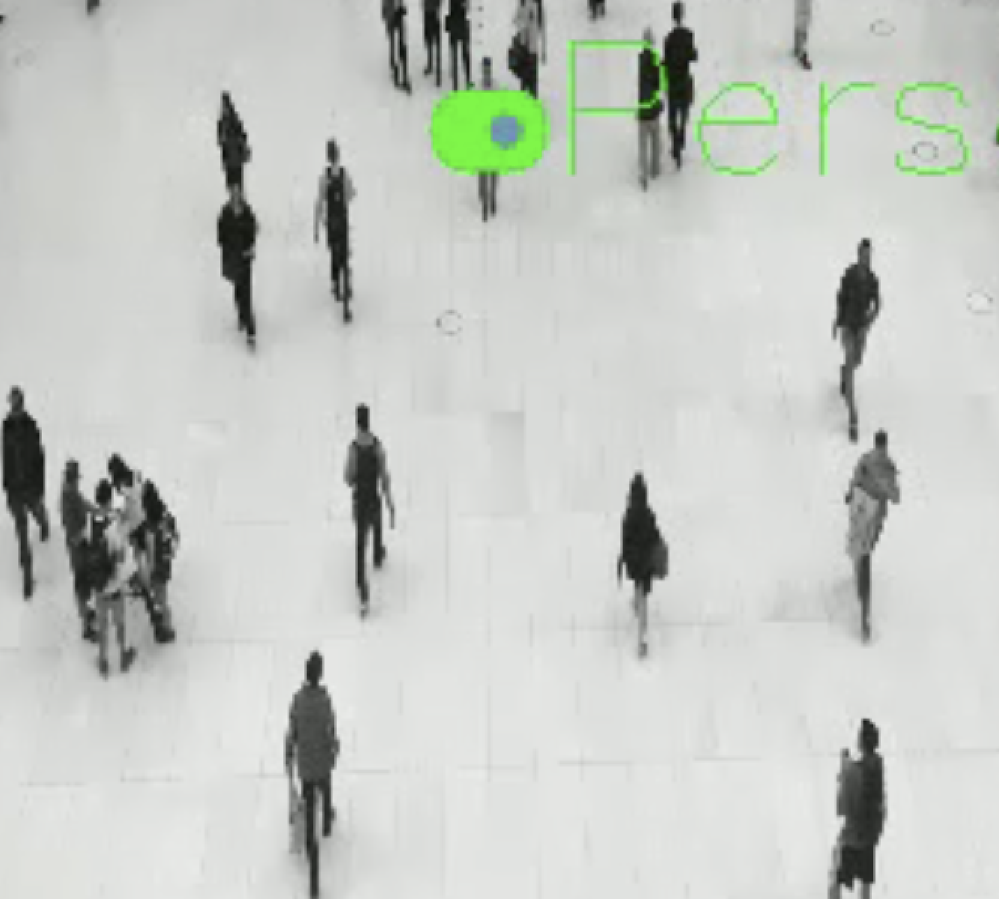

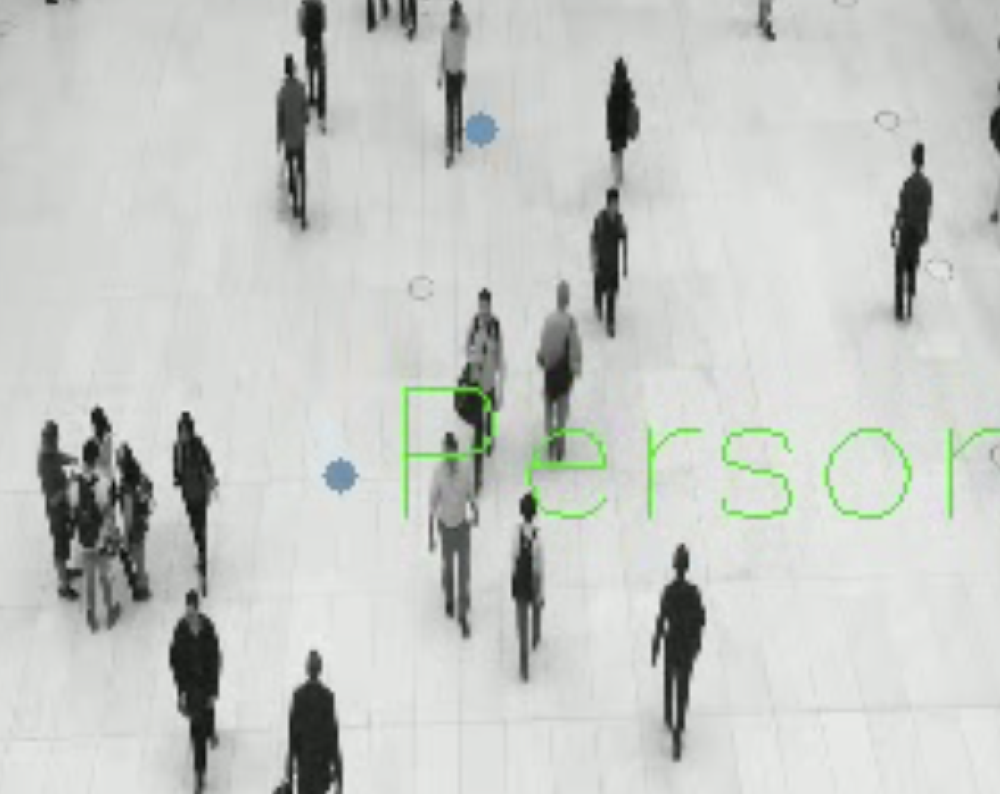

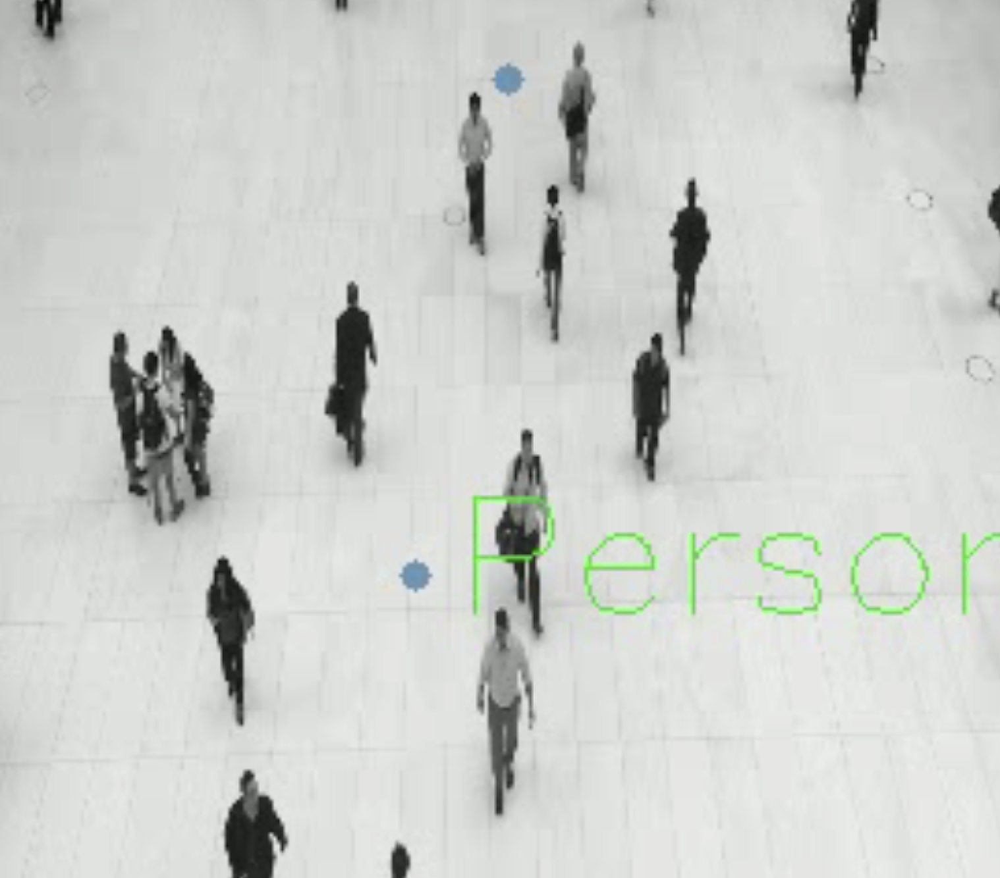

In [52]:
img = cv.imread('Resultados_entrega/Resultados_LK/Resultado_LK_1.png')
img2 = cv.imread('Resultados_entrega/Resultados_LK/Resultado_LK_2.png')
img3 = cv.imread('Resultados_entrega/Resultados_LK/Resultado_LK_3.png')
cv2_imshow(img)
cv2_imshow(img2)
cv2_imshow(img3)

### Método Lucas-Kanade usando pirámides para detectar mejor el movimiento

En la siguiente función 'calculate_optical_flow_pyramidal' hace uso de pirámides gaussianas para construir imágenes de menor resolución, de manera que el cálculo del flujo óptimo comenzaría en niveles de baja resolución con el fin de manejar desplazamientos grandes y mejorar la convergencia.

En cada nivel de la pirámide (comienza por el nivel más bajo), se calcularán los gradientes espaciales y temporal en ventanas locales con la aproximación lineal usada para estimar desplazamientos.

Los vectores de flujo calculados en cada nivel se ajustan y escalan para adaptarse al siguiente nivel de mayor resolución, acumulando los desplazamientos entre niveles, devolviendo de esta forma los vectores de flujo finales que representan los desplazamientos calculados para los puntos entre las dos imágenes.

In [54]:
import copy
people = copy.deepcopy(tracking_people)

In [58]:
def calculate_optical_flow_pyramidal(prev_img, curr_img, points_prev, levels=3):
    pyramid_prev = [prev_img]
    pyramid_curr = [curr_img]
    for i in range(1, levels):
        pyramid_prev.append(cv.pyrDown(pyramid_prev[i - 1]))
        pyramid_curr.append(cv.pyrDown(pyramid_curr[i - 1]))

    scale = 4 ** (levels - 1)
    scaled_points = points_prev / scale
    flow_vectors = np.zeros_like(scaled_points)

    for level in range(levels - 1, -1, -1):
        scale = 2 ** level
        curr_prev_img = pyramid_prev[level]
        curr_curr_img = pyramid_curr[level]

        updated_points = scaled_points + flow_vectors
        flow_vectors_at_level = []

        for point in updated_points:
            x, y = point.ravel().astype(int)
            x_start, x_end = max(0, x - 7), min(curr_prev_img.shape[1], x + 7)
            y_start, y_end = max(0, y - 7), min(curr_prev_img.shape[0], y + 7)

            Ix = cv.Sobel(curr_prev_img, cv.CV_64F, 1, 0, ksize=5)[y_start:y_end, x_start:x_end]
            Iy = cv.Sobel(curr_prev_img, cv.CV_64F, 0, 1, ksize=5)[y_start:y_end, x_start:x_end]
            It = curr_curr_img[y_start:y_end, x_start:x_end] - curr_prev_img[y_start:y_end, x_start:x_end]

            A = np.stack((Ix.ravel(), Iy.ravel()), axis=1)
            b = -It.ravel()

            try:
                AtA = A.T @ A
                Atb = A.T @ b
                flow = np.linalg.inv(AtA) @ Atb
            except np.linalg.LinAlgError:
                flow, _, _, _ = np.linalg.lstsq(A, b, rcond=None)

            flow_vectors_at_level.append(flow)

        flow_vectors = np.array(flow_vectors_at_level) + flow_vectors * 2  # Ajustar flujo al nivel superior

    return flow_vectors

In [ ]:
video = cv.VideoCapture("/content/drive/MyDrive/PIAV/data/people2.mp4")
status, img = video.read()
size = (1280, 1280)

fourcc = cv.VideoWriter_fourcc(*'DIVX')
video_out = cv.VideoWriter('/content/drive/MyDrive/PIAV/outputs/lucas_kanade_pyramidal.mp4', fourcc, 30.0, size)

tracking_person = tracking_people[0]

frame = 0
prev_gray = None
tracking_points = []

while status:
    orig = img.copy()
    orig = cv.resize(orig, (1280, 1280))
    gray = cv.cvtColor(orig, cv.COLOR_BGR2GRAY)

    if frame == 0:
        initial_point = np.array([[tracking_person.tracking[0][1][0], tracking_person.tracking[0][1][1]]], dtype=np.float32)
        tracking_points.append(initial_point[0])
        prev_gray = gray
    else:
        flow_vectors = calculate_optical_flow_pyramidal(prev_gray, gray, initial_point, levels=3)
        dx, dy = flow_vectors[0]

        initial_point[0][0] += dx
        initial_point[0][1] += dy

        tracking_points.append(initial_point[0].copy())

        for point in tracking_points:
            cv.circle(orig, (int(point[0]), int(point[1])), 5, (0, 255, 0), -1)

        cv.circle(orig, (int(initial_point[0][0]), int(initial_point[0][1])), 10, (0, 0, 255), -1)

    prev_gray = gray.copy()
    video_out.write(orig)
    status, img = video.read()

    frame += 1
    if frame == 100:
        break

video.release()
video_out.release()

print("Seguimiento con Lucas-Kanade piramidal completado. Video guardado.")

Seguimiento con Lucas-Kanade piramidal completado. Video guardado.


#### Resultados

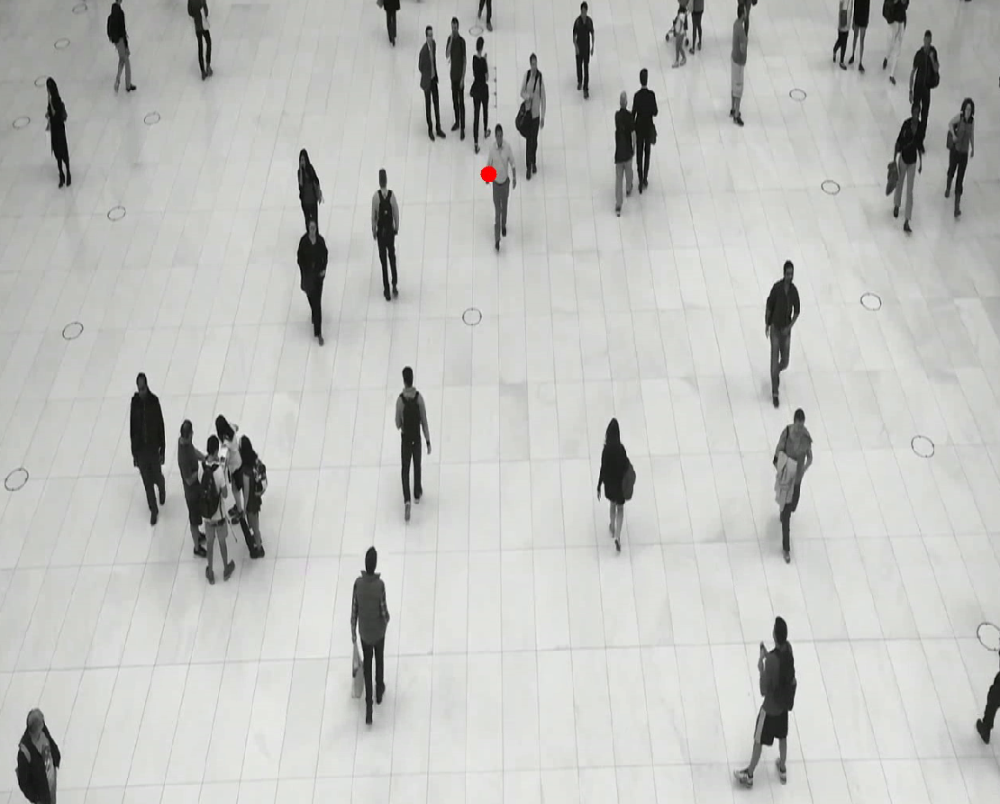

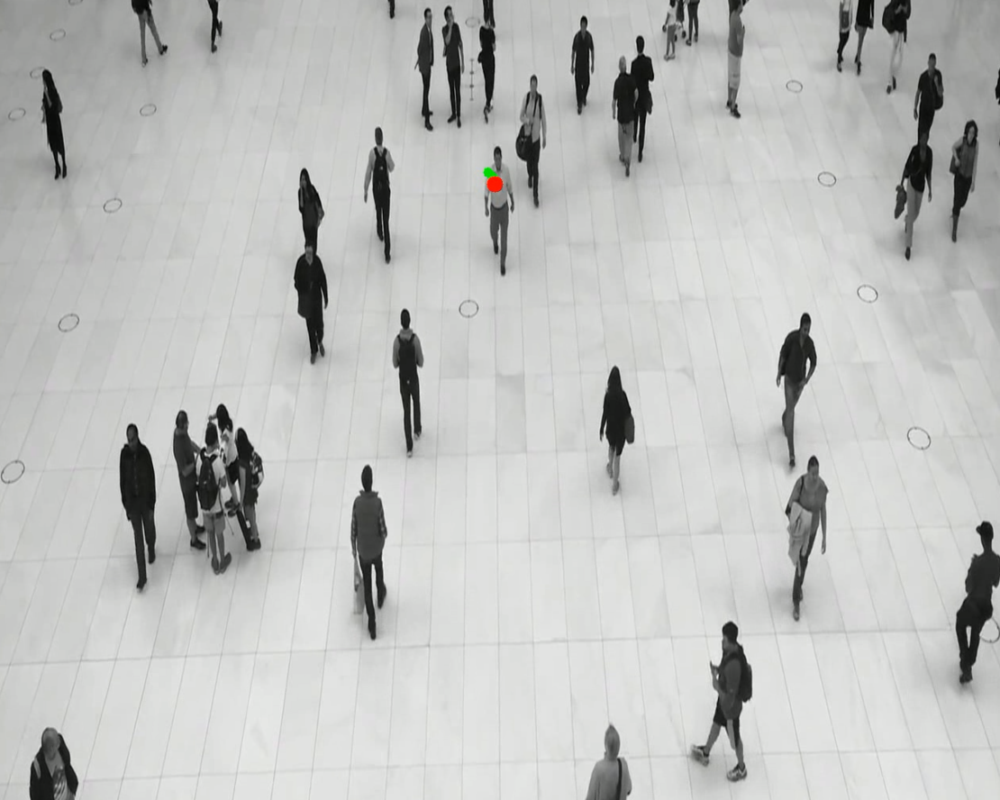

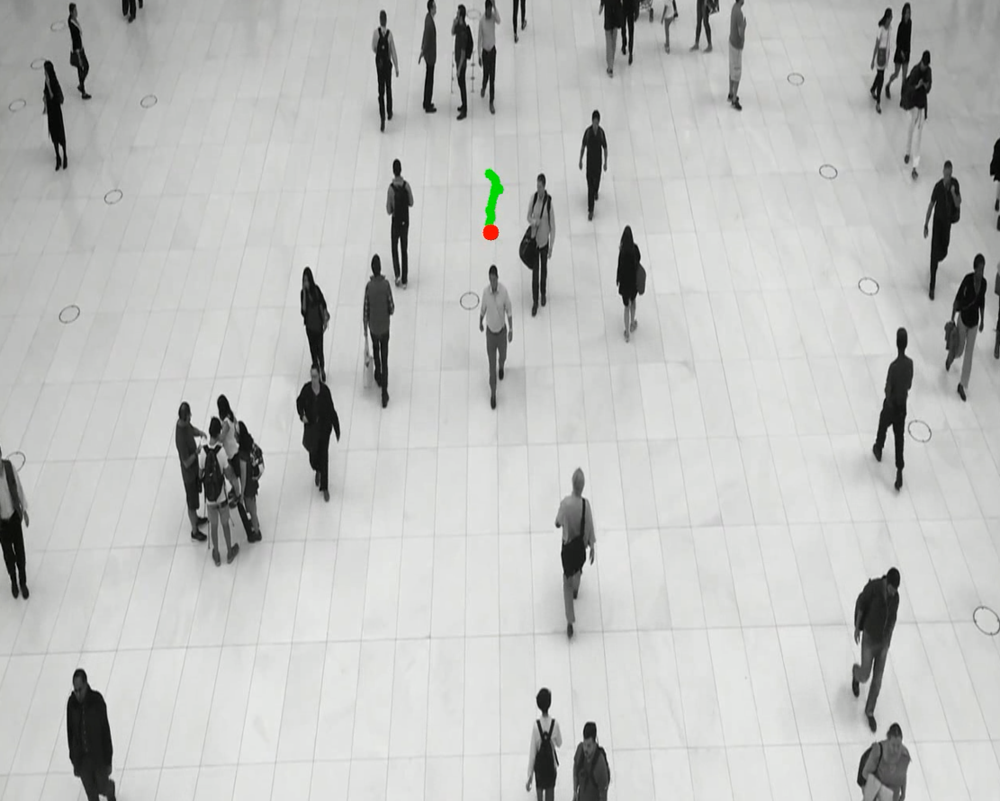

In [53]:
img = cv.imread('Resultados_entrega/Resultados_LK_piramide/Resultado_LK_1.png')
img2 = cv.imread('Resultados_entrega/Resultados_LK_piramide/Resultado_LK_2.png')
img3 = cv.imread('Resultados_entrega/Resultados_LK_piramide/Resultado_LK_3.png')
cv2_imshow(img)
cv2_imshow(img2)
cv2_imshow(img3)

Para este método sí que conseguimos un mejor resultado. SI probamos ahora para una menor resolución:

In [59]:
import copy
people = copy.deepcopy(tracking_people)

In [63]:
video = cv.VideoCapture("data/people2.mp4")
status, img = video.read()
size = (320, 320)

fourcc = cv.VideoWriter_fourcc(*'DIVX')
video_out = cv.VideoWriter('outputs/lucas_kanade_pyramidal.mp4', fourcc, 30.0, size)

tracking_person = tracking_people[0]

frame = 0
prev_gray = None
tracking_points = []

while status:
    orig = img.copy()
    orig = cv.resize(orig, size)
    gray = cv.cvtColor(orig, cv.COLOR_BGR2GRAY)

    if frame == 0:
        initial_point = np.array([[320 / 1280*tracking_person.tracking[0][1][0], 320 / 1280*tracking_person.tracking[0][1][1]]], dtype=np.float32)
        tracking_points.append(initial_point[0])
        prev_gray = gray
    else:
        flow_vectors = calculate_optical_flow_pyramidal(prev_gray, gray, initial_point, levels=3)
        dx, dy = flow_vectors[0]

        initial_point[0][0] += dx
        initial_point[0][1] += dy

        tracking_points.append(initial_point[0].copy())

        for point in tracking_points:
            cv.circle(orig, (int(point[0]), int(point[1])), 5, (0, 255, 0), -1)

        cv.circle(orig, (int(initial_point[0][0]), int(initial_point[0][1])), 10, (0, 0, 255), -1)

    prev_gray = gray.copy()
    video_out.write(orig)
    status, img = video.read()

    frame += 1
    if frame == 300:
        break

video.release()
video_out.release()

print("Seguimiento con Lucas-Kanade piramidal completado. Video guardado.")

Seguimiento con Lucas-Kanade piramidal completado. Video guardado.


Ahora sí, obtenemos buenísimos resultados, como se puede apreciar en el vídeo guardado en resultados, así como en las siguientes imágenes.

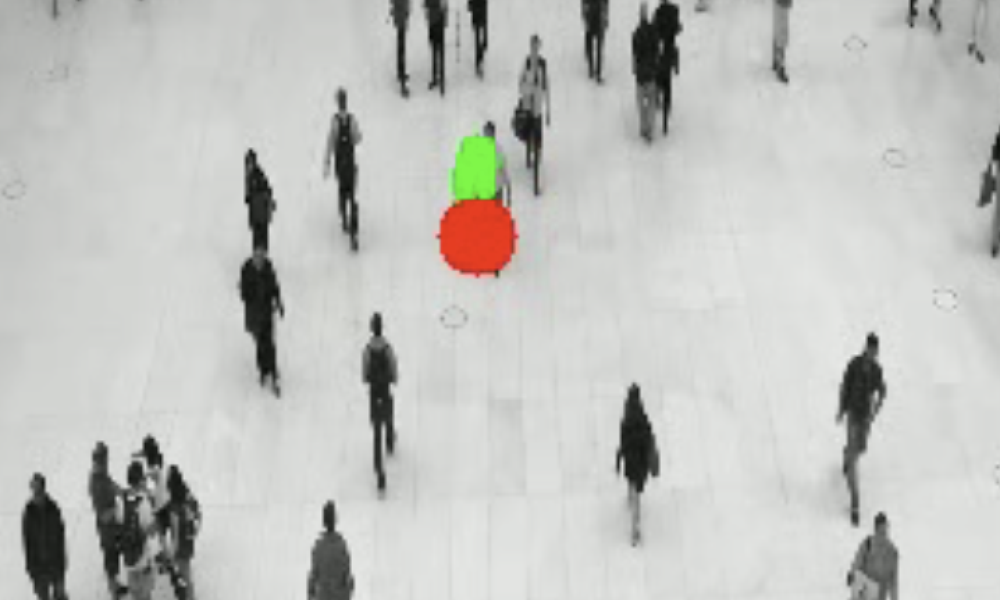

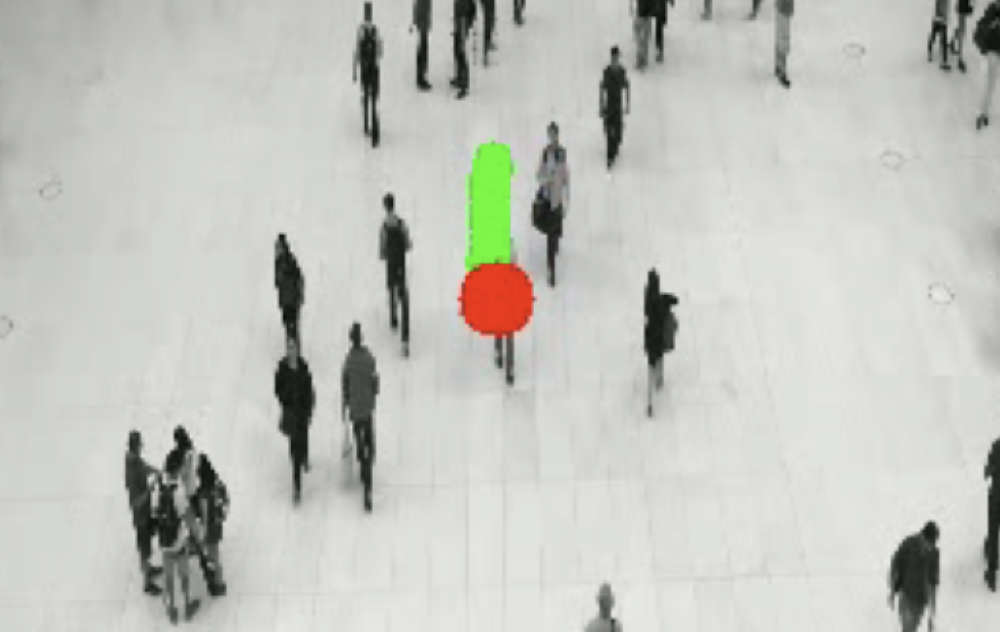

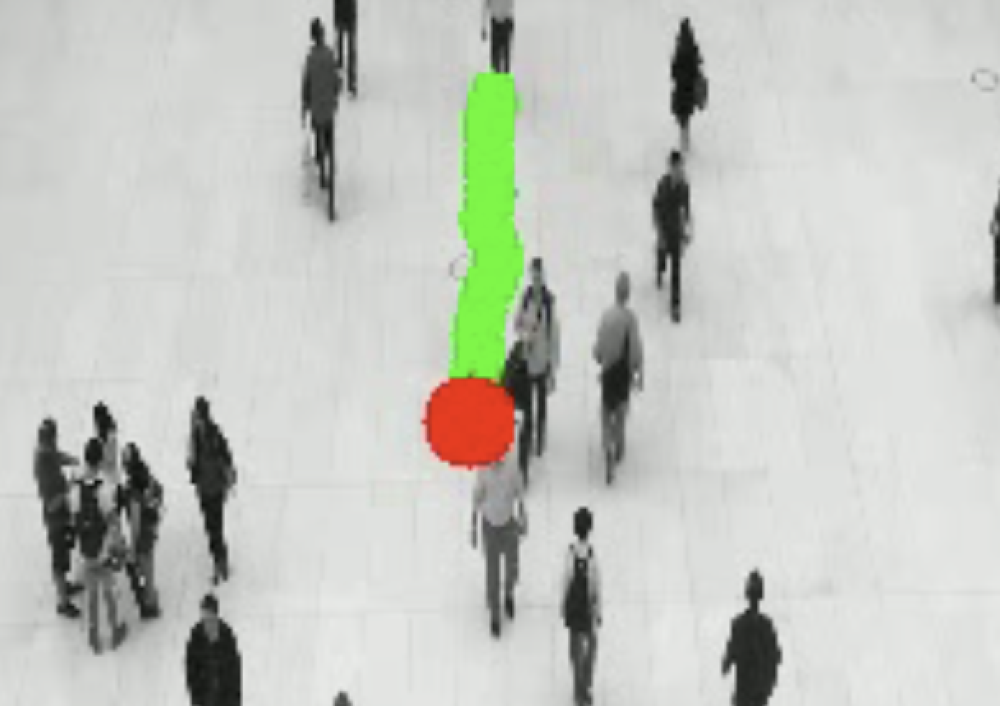

In [66]:
img = cv.imread('Resultados_entrega/Resultados_LK_piramide_menos_resolucion/Resultado_LK_1.png')
img2 = cv.imread('Resultados_entrega/Resultados_LK_piramide_menos_resolucion/Resultado_LK_2.png')
img3 = cv.imread('Resultados_entrega/Resultados_LK_piramide_menos_resolucion/Resultado_LK_3.png')
cv2_imshow(img)
cv2_imshow(img2)
cv2_imshow(img3)

Podemos ver cómo el trackeo se realiza con éxito. Además, podemos deshacer la reducción de escala, para lo cual se procede de la misma forma en la que pasamos el punto inicial a una escala menor.

### Método Farnebäck

El método de Farneback utiliza la expansión polinómica para modelar localmente el cambio de intensidad en un vecindario de cada píxel. Este enfoque aproxima el vecindario de cada píxel mediante polinomios cuadráticos, permitiendo una estimación robusta del desplazamiento mediante la resolución de un sistema lineal​.

En el siguiente código, se utiliza **cv.calcOpticalFlowFarneback** para calcular el flujo óptico, siguiendo el principio del campo de desplazamientos derivado de la expansión polinómica de Farneback. Esta función aproxima localmente cada vecindario de píxeles en ambas imágenes como polinomios cuadráticos y calcula los desplazamientos evaluando cómo cambian los coeficientes de estos polinomios entre las dos imágenes.

Luego, integra información del movimiento con pesos basados en una función gaussiana para reducir el ruido y mejorar la robustez, y aplica un refinamiento multiescala que comienza en una resolución más baja (escala gruesa) para manejar desplazamientos grandes y ajusta progresivamente los resultados en escalas más altas (resoluciones más finas).

In [ ]:
video = cv.VideoCapture("/content/drive/MyDrive/PIAV/data/people2.mp4")
status, img = video.read()
size = (1280, 1280)

fourcc = cv.VideoWriter_fourcc(*'DIVX')
video_out = cv.VideoWriter('/content/drive/MyDrive/PIAV/outputs/farneback_tracking.mp4', fourcc, 30.0, size)

tracking_person = tracking_people[0]

frame = 0
prev_gray = None
tracking_points = []

while status:
    orig = img.copy()
    orig = cv.resize(orig, (1280, 1280))

    gray = cv.cvtColor(orig, cv.COLOR_BGR2GRAY)

    if frame == 0:
        initial_point = np.array([tracking_person.tracking[0][1][0], tracking_person.tracking[0][1][1]], dtype=np.float32)
        tracking_points.append(initial_point)
        prev_gray = gray
    else:
        flow = cv.calcOpticalFlowFarneback(prev_gray, gray, None, 0.5, 3, 15, 3, 5, 1.2, 0)

        dx = flow[int(initial_point[1]), int(initial_point[0]), 0]
        dy = flow[int(initial_point[1]), int(initial_point[0]), 1]

        initial_point[0] += dx
        initial_point[1] += dy

        tracking_points.append(initial_point.copy())

        for point in tracking_points:
            cv.circle(orig, (int(point[0]), int(point[1])), 5, (0, 255, 0), -1)

        cv.circle(orig, (int(initial_point[0]), int(initial_point[1])), 10, (0, 0, 255), -1)

    prev_gray = gray.copy()

    video_out.write(orig)

    status, img = video.read()

    frame += 1
    if frame == 100:
        break

# Liberar recursos
video.release()
video_out.release()

print("Seguimiento con Farneback completado. Video guardado.")

Seguimiento con Farneback completado. Video guardado.


#### Resultados

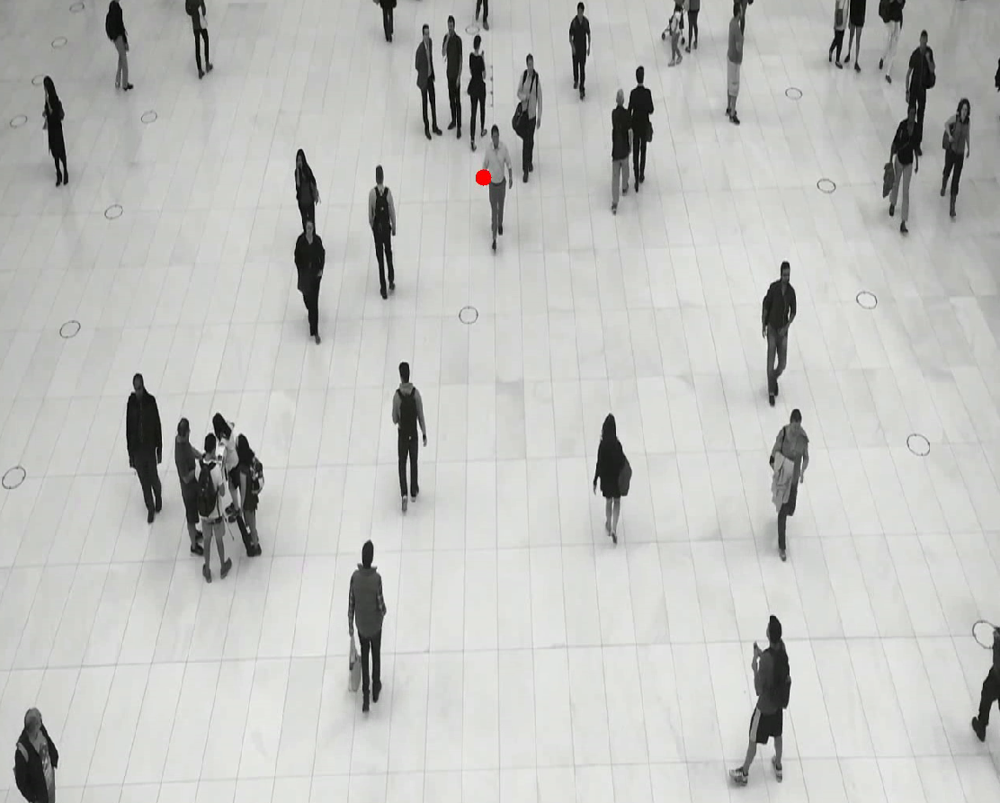

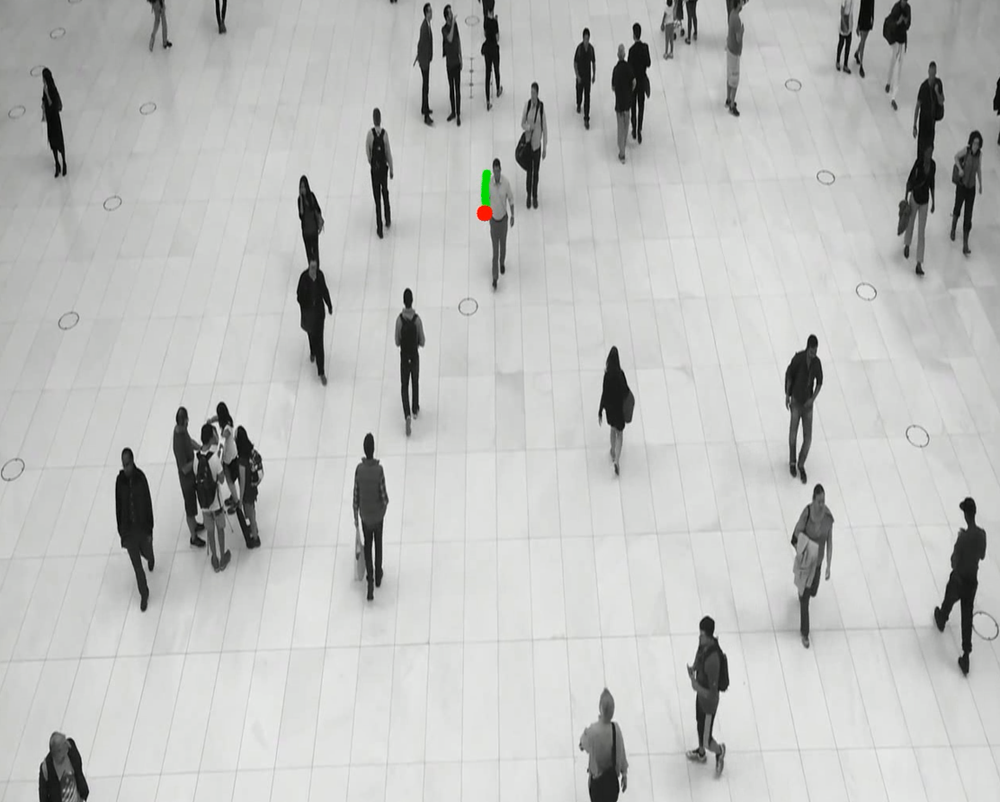

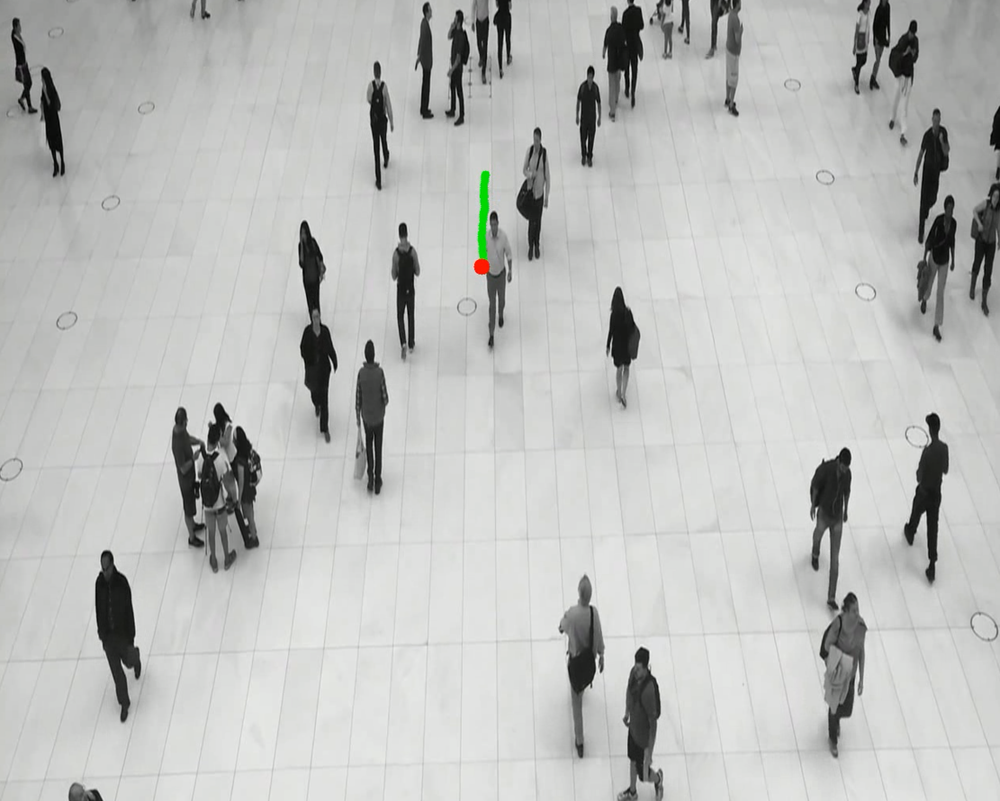

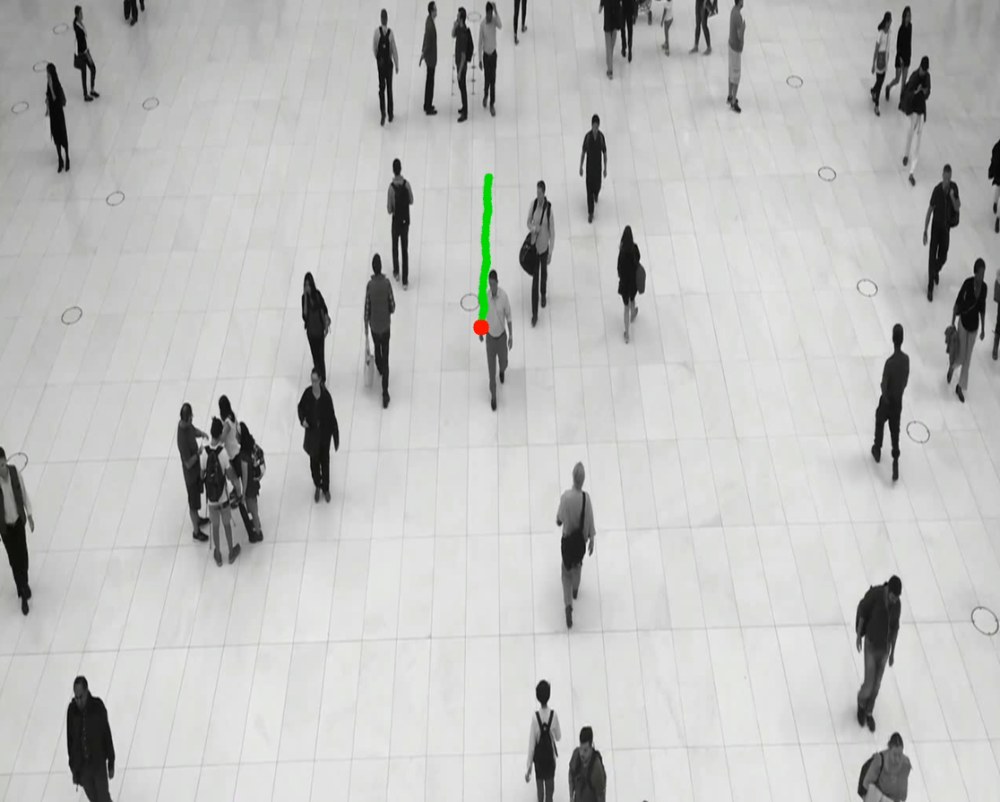

In [71]:
img = cv.imread('Resultados_entrega/Resultados_Farneback/Resultados_Farneback_1.png')
img2 = cv.imread('Resultados_entrega/Resultados_Farneback/Resultados_Farneback_2.png')
img3 = cv.imread('Resultados_entrega/Resultados_Farneback/Resultados_Farneback_3.png')
img4 = cv.imread('Resultados_entrega/Resultados_Farneback/Resultados_Farneback_4.png')
cv2_imshow(img)
cv2_imshow(img2)
cv2_imshow(img3)
cv2_imshow(img4)